# Schamel Sech4 electron hole

In [1]:
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib
import scipy.optimize as op
import plasmapy
from scipy import special as sp
from scipy import integrate
from tqdm import tqdm
import numba as nb
import math
import matplotlib.cm as cm
from prettytable import PrettyTable
from scipy.optimize import curve_fit
%config InlineBackend.figure_format = 'svg'

In [2]:
plt.rcParams.update({'font.size': 16})
plt.rcParams.update({'lines.linewidth': 2})

In [32]:
T = 1
# k = 0.1
# L = 2*np.pi/k
L = 100

vmax = 10 # 速度最大值
nx = 500
nv = 500
dx = L/(nx-1)
dv = 2*vmax/(nv-1)
x = np.linspace(0, L, num=nx, endpoint=True)
v = np.linspace(-vmax, vmax, num=nv, endpoint=True)
V,X=np.meshgrid(v,x)

c1 = 0
c2 = 0

dt = 0.05
max_steps  = 5000
data_steps = max_steps
data_num = int(max_steps/data_steps)+1

path = 'E:/代码/vlasov-es1d/data/'

# self-consistent solution of electron hole

## Schamel distribution
$$ f_e (v^2>2\phi) = \exp \left[ -\frac{\left(\sqrt{v^2-2\phi}+u\right)^2}{2} \right] $$
$$ f_e (v^2<2\phi) = \exp \left[ -\beta \left(\frac{v^2}{2}-\phi\right) - \frac{u^2}{2} \right] $$
其中$v$为孤波参考系中的速度，静系速度$v_0=v+u$
- 此分布下的自洽孤波，用Newton-Raphson法解出

In [16]:
psi = 0.290
# del_x = 8.655

In [17]:
u = 1.25
r1 = 1 + 0.5*u/np.sqrt(2)*plasmapy.dispersion.plasma_dispersion_func(u/np.sqrt(2)).real - 0.5*u/np.sqrt(2)*plasmapy.dispersion.plasma_dispersion_func(-u/np.sqrt(2)).real
del_x = 4.0/np.sqrt(r1)
b = r1*15/16/np.sqrt(psi)
beta = 1-u**2-np.sqrt(np.pi)*np.exp(u**2/2)*b

print(u,beta)
phi_sc = 0.7*psi*np.cosh((x-L/2)/del_x)**(-4)
print(psi,del_x)

1.25 -0.8667812221202987
0.29 18.825317270598806


In [18]:
beta = -0.7

In [19]:
# r1 = 1+u/np.sqrt(2)*plasmapy.dispersion.plasma_dispersion_func(u/np.sqrt(2)).real
# b = np.exp(-u**2/2)*(1-beta-u**2)/np.sqrt(np.pi)

# psi = (r1*15/16/b)**2
# del_x = 4.0/np.sqrt(r1)

In [20]:
@nb.jit
# def nonvec_f_sech4(v,phi):
#     r = 0
#     v_waveframe = v
#     w = v_waveframe**2/2-phi
#     if v_waveframe<=-abs(2*phi)**0.5:
#         r=math.exp(-(-(2*w)**0.5+u)**2/2) 
#     elif v_waveframe>abs(2*phi)**0.5:
#         r=math.exp(-( (2*w)**0.5+u)**2/2) 
#     else:
#         r =math.exp(-beta*w-u**2/2) 
#     return r/(2*np.pi)**0.5
def nonvec_f_sech4(v,phi):
    r = 0
    v_waveframe = v
    w = v_waveframe**2/2-phi
    if w>0:
        r = ( math.exp(-0.5*((2*w)**0.5+u)**2) + math.exp(-0.5*((2*w)**0.5-u)**2) )/2
    else:
        r =math.exp(-beta*w-u**2/2) 
    return r/(2*np.pi)**0.5
f_sech4 = np.vectorize(nonvec_f_sech4)

In [21]:
for count in tqdm(range(10)):
    V,Phi_sc=np.meshgrid(v,phi_sc)
    f_matrix = f_sech4(V,Phi_sc)
    n_sc = f_matrix.sum(axis=1)*dv
    
    dx2 = dx*dx
    laplace = -2.0*np.eye(nx-2,k=0)+np.eye(nx-2,k=1)+np.eye(nx-2,k=-1)
    
#     # natural BC
#     laplace[0][0]=-1
#     laplace[-1][-1]=-1
    
    r = (1.0 - n_sc[1:nx-1])*dx2 + np.dot(laplace,phi_sc[1:nx-1])
    
    # Dirichlet BC phi[0]=c1 phi[-1]=c2
    r[0]  += c1
    r[-1] += c2
    
    m = 2.0 + (n_sc[2:nx]-n_sc[0:nx-2])/(phi_sc[2:nx]-phi_sc[0:nx-2])*dx2
    nr_mat = np.diag(m) - np.eye(nx-2,k=1) - np.eye(nx-2,k=-1)
    dphi = np.linalg.solve(nr_mat,r)
    phi_sc[1:nx-1] += dphi
    
    err = ((dphi/phi_sc[1:nx-1])**2).sum()
    if err<= 1e-6:
        print("Sucess! Iteration counts =", count)
#         print("err =", err)
        break
print(err)

 30%|█████████████████████████████████████████████████████████▉                                                                                                                                       | 3/10 [00:00<00:01,  5.23it/s]

Sucess! Iteration counts = 3
2.6787502387603244e-08


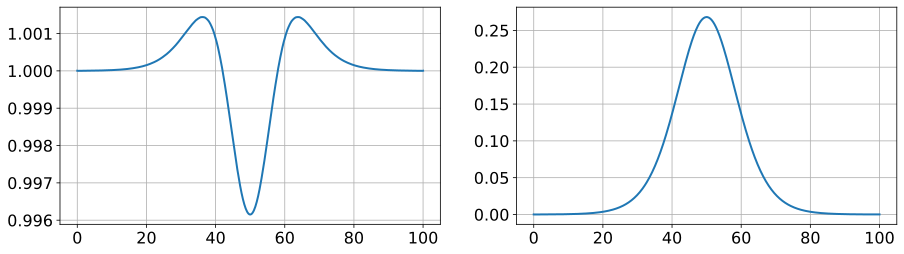

In [22]:
fig = plt.figure(figsize=(15,4))
ax1 = plt.subplot(121)
ax1.plot(x,n_sc)
ax1.grid()
ax3 = plt.subplot(122)
ax3.plot(x,phi_sc)
ax3.grid()
# ax3.set_xlim(0.3*L,0.7*L)
# ax3.set_yscale('log')
plt.show()

In [23]:
xc = L/2
def phi4_theo(x,a,da):
    xp = (x-xc)/da
    return a*np.cosh(xp)**(-4)
para4,pcov=curve_fit(phi4_theo,x,phi_sc)
print(para4)

[ 0.26744708 16.85008051]


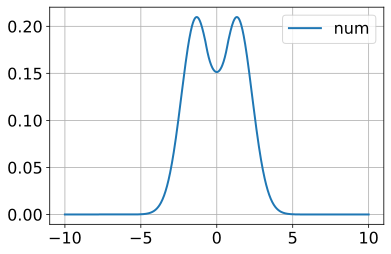

In [374]:
V,Phi_sc=np.meshgrid(v,phi_sc)
f_sech4_matrix = f_sech4(V,Phi_sc)
plt.plot(v,f_sech4_matrix[int(nx/2),],label='num')
plt.legend()
# plt.ylim(0.05,0.31)
plt.grid()

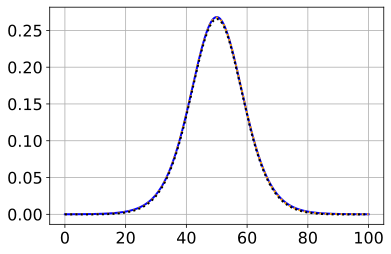

In [383]:
#xc=34
plt.plot(x,phi_sc,color='blue')
plt.plot(x,phi4_theo(x,para4[0],para4[1]),linestyle=':',color='orange')
plt.plot(x,phi[0],linestyle=':',color='black')
plt.grid()
#plt.xlim(20,40)
plt.show()

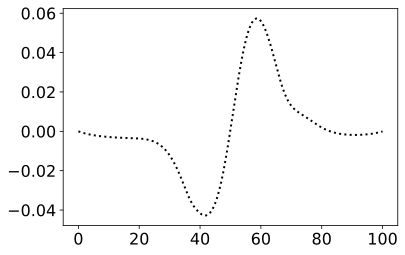

In [376]:
plt.plot(x,phi[1]-phi_sc,linestyle=':',color='black')

In [46]:
progesses = np.arange(0,data_num,1)

fe = []
fi = []
phi = []

for progess in progesses:
    fe_temp = np.loadtxt(os.path.join(path,"fe"+str(progess)))
    fe.append(fe_temp)
    fi_temp = np.loadtxt(os.path.join(path,"fi"+str(progess)))
    fi.append(fi_temp)
    phi_temp = np.loadtxt(os.path.join(path,"phi"+str(progess)))
    phi.append(phi_temp)

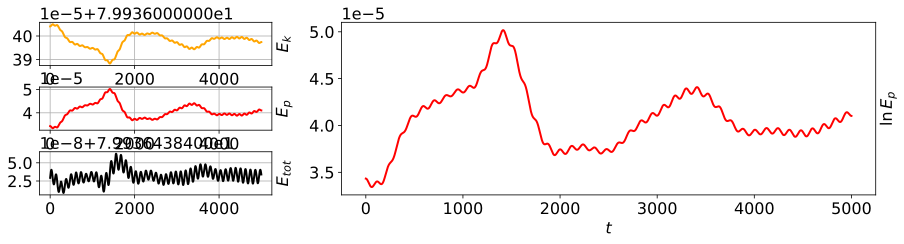

In [47]:
dataet = np.loadtxt(os.path.join(path,"tot_energy"))[0:max_steps]
dataep = np.loadtxt(os.path.join(path,"pot_energy"))[0:max_steps]
dataek = np.loadtxt(os.path.join(path,"kin_energy"))[0:max_steps]

t = np.linspace(0, max_steps, max_steps)
fig = plt.figure(figsize=(15, 3))

ax1 = plt.subplot2grid((3, 3), (0, 0))
ax1.plot(t, dataek, color='orange')
ax1.grid()
ax1.set_ylabel(r'$E_k$')
ax1.yaxis.set_label_position("right")

ax2 = plt.subplot2grid((3, 3), (1, 0))
ax2.plot(t, dataep, color='r')
ax2.grid()
ax2.set_ylabel(r'$E_p$')
ax2.yaxis.set_label_position("right")

ax3 = plt.subplot2grid((3, 3), (2, 0))
ax3.plot(t, dataet, color='black')
ax3.grid()
ax3.set_ylabel(r'$E_{tot}$')
ax3.yaxis.set_label_position("right")

axl2 = plt.subplot2grid((3, 3), (0, 1),colspan=2, rowspan=3)
axl2.plot(t, dataep, color='r')
axl2.set_ylabel(r'$\ln E_p$')
# axl2.set_yscale('log')
axl2.yaxis.set_label_position("right")

fig.subplots_adjust(bottom=0.1, top=0.9, hspace=.5, wspace=.3)
plt.xlabel(r'$t$')
plt.show()

In [48]:
fx0 = np.sum(fe[0],axis=1)*dv

In [49]:
fig = plt.figure(figsize=(8, 6))

test_frame = 1
fx = np.sum(fe[test_frame],axis=1)*dv
fv = np.sum(fe[test_frame],axis=0)*dx/L
lvs_idx = np.linspace(-10,1,num=50)
lvs = 10**lvs_idx

ax1 = plt.subplot2grid((2, 2), (0, 0))
ax1cm = ax1.contourf(X, V, fe[test_frame], levels=20,cmap=cm.plasma)
ax1.set_xlabel(r'$x$')
ax1.set_ylabel(r'$v$')
ax1.set_ylim(-2.5,2.5)

ax2 = plt.subplot2grid((2, 2), (0, 1))
ax2cm = ax2.contourf(X, V, fi[test_frame], levels=20,cmap=cm.plasma)
ax2.set_xlabel(r'$x$')
ax2.set_ylabel(r'$v$')
ax2.set_ylim(-1.2,-0.5)

ax3 = plt.subplot2grid((2, 2), (1, 0))
ax3.plot(x, fx, color='red')
ax3.plot(x, fx0,'--', color='blue')
ax2.set_xlabel(r'$v$')
ax3.set_xlabel(r'$x$')
ax3.set_ylabel(r'$fx$')
ax3.grid()

ax4 = plt.subplot2grid((2, 2), (1, 1))
ax4.plot(x, phi[test_frame], color='red')
ax4.plot(x, phi[0],'--', color='blue')
ax4.set_xlabel(r'$x$')
ax4.set_ylabel(r'$\phi$')
ax4.grid()

plt.tight_layout()

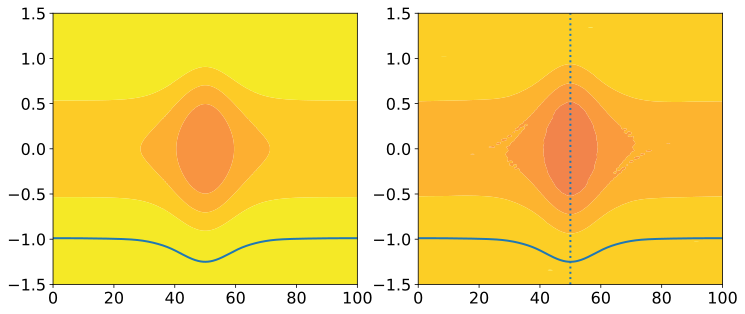

In [50]:
ux = -np.sqrt(u**2-2*phi[1][250]+2*phi[1])
testx=int(nx/2)
fig = plt.figure(figsize=(12, 5))
ax1 = plt.subplot(121)
plt.contourf(X, V, fe[0], levels=15, cmap=cm.plasma)
plt.plot(x,ux)
plt.ylim(-1.5,1.5)

ax2 = plt.subplot(122)
plt.contourf(X, V, fe[test_frame], levels=15, cmap=cm.plasma)
plt.plot(x,ux)
plt.axvline(testx/nx*L,linestyle=':')
# plt.xlim(0.25*L,0.75*L)
plt.ylim(-1.5,1.5)
plt.show()

NameError: name 'f_sech4_matrix' is not defined

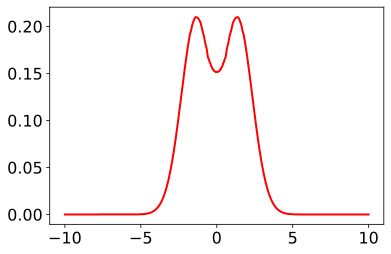

In [51]:
plt.plot(v,fe[1][testx],color='red')
plt.plot(v,f_sech4_matrix[testx,],linestyle='--',color='black')
plt.axvline(-np.sqrt(2*phi[1][testx]),linestyle=':')
# plt.yscale('log')
plt.xlim(-4,0)
plt.grid()
plt.show()

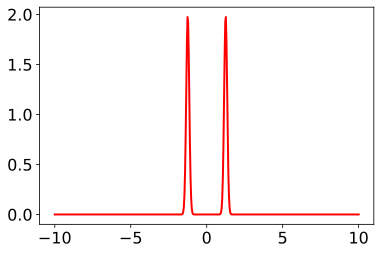

In [52]:
plt.plot(v,fi[1][testx],color='red')